In [1]:
# RunPod Notebook Setup
import os
import sys

# Set the root directory for your repo
root_dir = "/workspace/image-captioning"
os.chdir(root_dir)

# Add repo to Python path
sys.path.append(root_dir)

# Optional: clone from GitHub if not already cloned
# !git clone https://github.com/srinivasa-chandakanna/image-captioning.git

print("Current working directory:", os.getcwd())

os.environ["TOKENIZERS_PARALLELISM"] = "false"
# Install all dependencies listed in requirements.txt
!pip install -r requirements.txt --force-reinstall --no-cache-dir

# Download extra NLP resources
!python -m nltk.downloader punkt
!python -m spacy download en_core_web_sm



Current working directory: /workspace/image-captioning
INFO: pip is looking at multiple versions of opencv-python-headless to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of scikit-image to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 670.2/670.2 MB 187.7 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 262.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 261.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 195.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 391.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 198.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 208.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 403.5 MB/s eta 0:00:

# Training the PyTorch models:

1.   Scratch CNN + LSTM : CNN built from scratch (no pre-trained features), + LSTM decoder
2.   Resnet (pretrained) + LSTM : ResNet50 fully frozen (feature extractor only) + LSTM decoder
3.   Resnet (finetuned) + LSTM : ResNet50 fine-tuned (layer3 & layer4) with Dropout+BatchNorm head + LSTM decoder
4. Resnet (Fine Tune 2) + LSTM : ResNet50 fine-tuned (layer2,3 & 4) with Dropout+BatchNorm head + LSTM decoder
5. ResNET (Fine Tune 2) + Attention + LSTM decoder





Train the model to create the model and save it in Artifacts Folder

*   train the model to create the model and save it in Artifacts Folder (model.pth: best model & last epach )
*   These files will be used for Image Captiioning

All outputs (png, csv, metatdata) saved in /outputs folder



In [2]:
# Run this to train the model
#!python scripts/train.py
from imgcapgen.scripts.train import run_training_pipeline
# -----------------------------------------
# Choose dataset & model
# -----------------------------------------
available_configs = {
    "flickr8k": "config/config_flickr8k.yaml",
    "flickr30k": "config/config_flickr30k.yaml",
}

available_models = {
    "ScratchCNN_LSTM": "scratchcnn_lstm",
    "Resnet_LSTM": "resnet_lstm",
    "ResnetFinetune_LSTM": "resnetfinetune_lstm",
    "ResnetFinetune2_LSTM": "resnetfinetune2_lstm",
    "ResnetFinetune2_Attention_LSTM": "resnetfinetune2_attention_lstm",
    "ResnetFinetune2_Attention2_LSTM": "resnetfinetune2_attention2_lstm",
    "ResnetFinetune2_Attention3_LSTM": "resnetfinetune2_attention3_lstm",
    "ResnetFinetune2_Attention4_LSTM": "resnetfinetune2_attention4_lstm",
}

## 1. Scratch CNN + LSTM model Training


 Training ScratchCNN_LSTM on flickr8k dataset...

💻 Running on Local Machine: /workspace/image-captioning
[INFO] Root directory detected: /workspace/image-captioning


100%|██████████| 1.04G/1.04G [00:06<00:00, 161MB/s] 

Extracting files...


[INFO] Kaggle dataset downloaded to: /root/.cache/kagglehub/datasets/srinivasac/flickr8k-dataset/versions/1

✅ Paths configured:
📂 Image path:    /root/.cache/kagglehub/datasets/srinivasac/flickr8k-dataset/versions/1/flickr8k/Images
📝 Captions path: /root/.cache/kagglehub/datasets/srinivasac/flickr8k-dataset/versions/1/flickr8k/captions.txt
💾 Artifacts dir: /workspace/image-captioning/artifacts/flickr8k
💾 Output dir:    /workspace/image-captioning/outputs/flickr8k

✅ Preprocess captions...
✅ Saved preprocessed captions to /workspace/image-captioning/artifacts/flickr8k/flickr8k_captions.csv


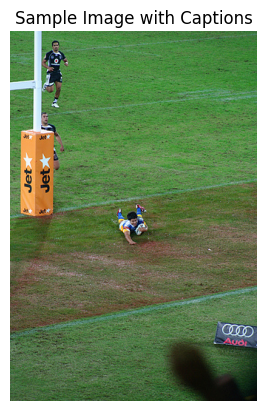

Caption - A rugby player wearing a colored top has scored a try as the players in black are running towards him .
Caption - A sports player on a field lying face down on the grass .
Caption - The young man dives on the field during a sporting event .
Caption - Three men on a field .
Caption - A large crowd in heavy clothing is posing for a camera .

✅ Sample Captions Data:
                       image  caption_number  \
0  1000268201_693b08cb0e.jpg               0   
1  1000268201_693b08cb0e.jpg               1   
2  1000268201_693b08cb0e.jpg               2   
3  1000268201_693b08cb0e.jpg               3   
4  1000268201_693b08cb0e.jpg               4   

                                             caption  id  
0  A child in a pink dress is climbing up a set o...   0  
1              A girl going into a wooden building .   0  
2   A little girl climbing into a wooden playhouse .   0  
3  A little girl climbing the stairs to her playh...   0  
4  A little girl in a pink dress going i

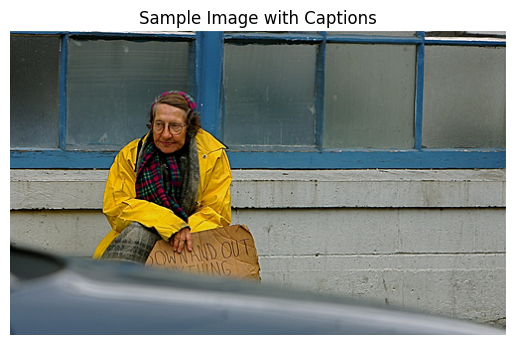

Caption - Man with a yellow coat and a cardboard sign .
Caption - Older woman in yellow jacket , holds sign saying " DOWN AND OUT " in urban area .
Caption - A man in a blue coat walks a small white animal as a buss passes in the background .
Caption - A man in a blue jacket holding a small white animal on a leash
Caption - A man in a blue jacket walks a small , white animal while a London Sightseeing bus drives behind him .

✅ Preprocess captions: Completed

✅ Data Split to Train/Validation: Started
[Transforms] Using mean=[0.458, 0.4461, 0.4039], std=[0.232, 0.223, 0.2272] for model=scratchcnn_lstm on dataset=flickr8k
✅ Saved vocab to: /workspace/image-captioning/artifacts/flickr8k
Number of unique tokens in vocab: 2667
Number of real words in vocab: 2663

✅ Sample Image & Tokens:


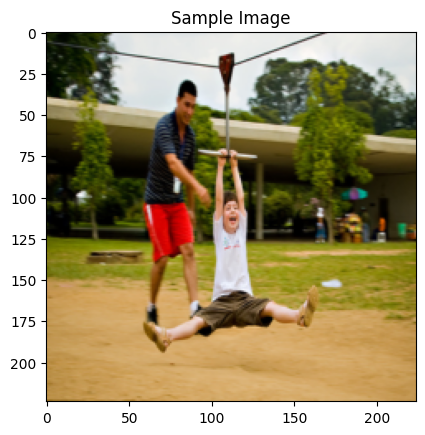

Token : tensor([  1,   4, 161,  43, 473,  97,   4, 130,  70, 264,  13,   5,   2])
Sentence: 
['<SOS>', 'a', 'smiling', 'boy', 'slides', 'down', 'a', 'rope', 'while', 'hanging', 'on', '.', '<EOS>']

✅ Sample Images in Batch:


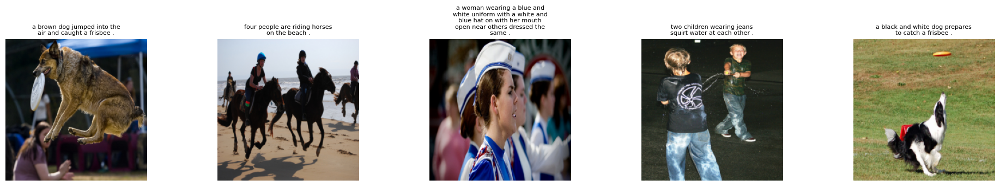


🚀 Starting training for: scratchcnn_lstm

📘 Epoch 1/25


Epoch 1: 100%|██████████| 506/506 [01:49<00:00,  4.63it/s]


✅ Epoch 1: Train Loss: 4.4684 | Val Loss: 3.7208
⏱️ Time: 2.28 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:   6%|▌         | 7/127 [00:01<00:27,  4.33it/s]

Sample 1:
 True: a man in a white shirt and helmet is using climbing equipment .
 Pred: <SOS> a man in a black dog in a <UNK> . <EOS>


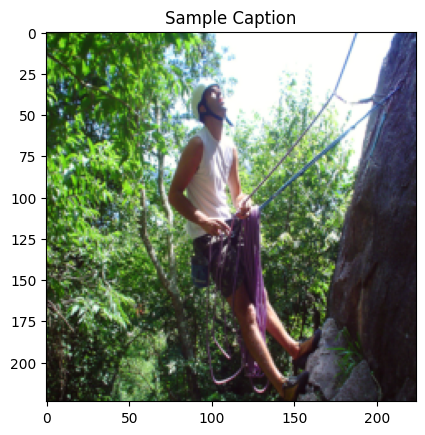

Evaluating:  65%|██████▍   | 82/127 [00:18<00:09,  4.68it/s]

Sample 2:
 True: three passengers on a train car .
 Pred: <SOS> a man in a black dog in a <UNK> . <EOS>


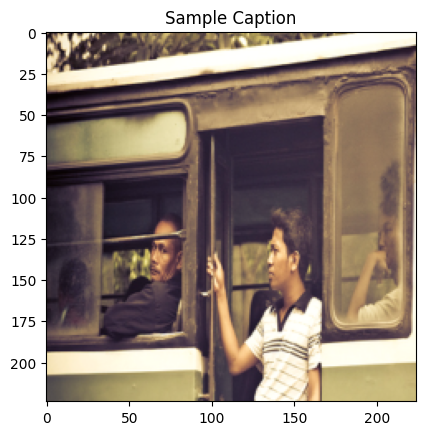

Evaluating:  76%|███████▌  | 96/127 [00:21<00:06,  4.57it/s]

Sample 3:
 True: two people are suspended in air in a metal ball as part of a carnival type ride .
 Pred: <SOS> a man in a black dog in a <UNK> . <EOS>


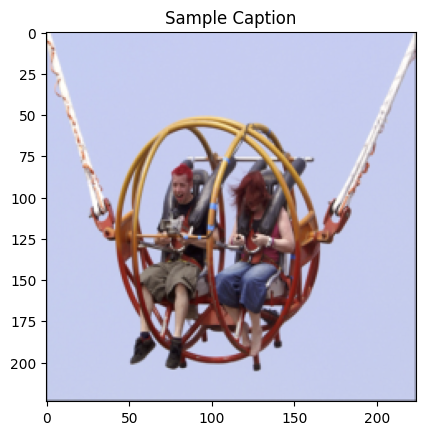

Evaluating: 100%|██████████| 127/127 [00:28<00:00,  4.48it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0442 | BLEU2: 0.1194 | BLEU3: 0.0729 | Cosine Similarity: 0.2311
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 2/25


Epoch 2: 100%|██████████| 506/506 [01:47<00:00,  4.73it/s]


✅ Epoch 2: Train Loss: 3.5736 | Val Loss: 3.3524
⏱️ Time: 2.24 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:   2%|▏         | 3/127 [00:01<00:39,  3.17it/s]

Sample 1:
 True: family sitting on a bench near the beach .
 Pred: <SOS> a man in a red shirt is running on a <UNK> . <EOS>


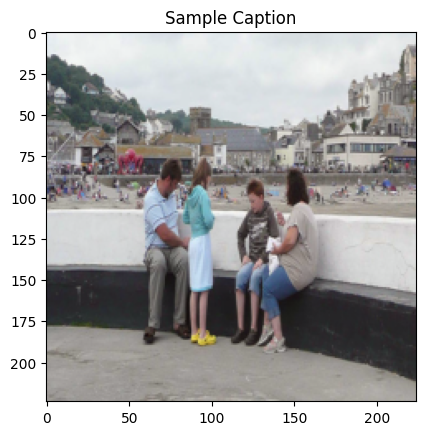

Evaluating:  17%|█▋        | 21/127 [00:05<00:26,  4.07it/s]

Sample 2:
 True: two children play and one has a beach ball .
 Pred: <SOS> a man in a red shirt is running on a <UNK> . <EOS>


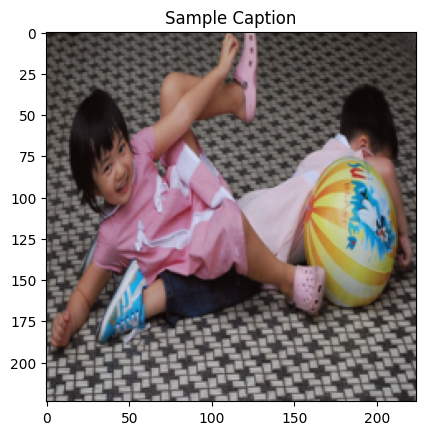

Evaluating:  50%|█████     | 64/127 [00:16<00:15,  4.04it/s]

Sample 3:
 True: a man and little girl are playing in an above ground swimming pool .
 Pred: <SOS> a man in a red shirt is running on a <UNK> . <EOS>


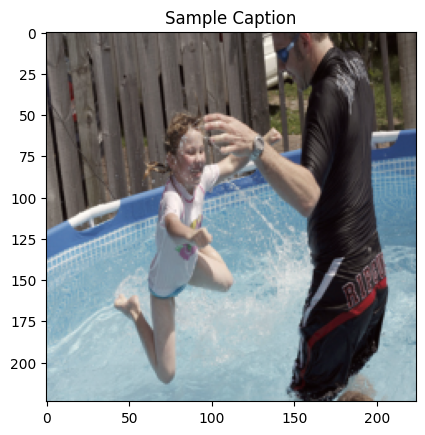

Evaluating: 100%|██████████| 127/127 [00:32<00:00,  3.94it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0412 | BLEU2: 0.1175 | BLEU3: 0.0688 | Cosine Similarity: 0.2953
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 3/25


Epoch 3: 100%|██████████| 506/506 [01:49<00:00,  4.61it/s]


✅ Epoch 3: Train Loss: 3.3085 | Val Loss: 3.1726
⏱️ Time: 2.29 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  35%|███▍      | 44/127 [00:11<00:20,  4.08it/s]

Sample 1:
 True: two young boys are playing in a fountain in a city plaza .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


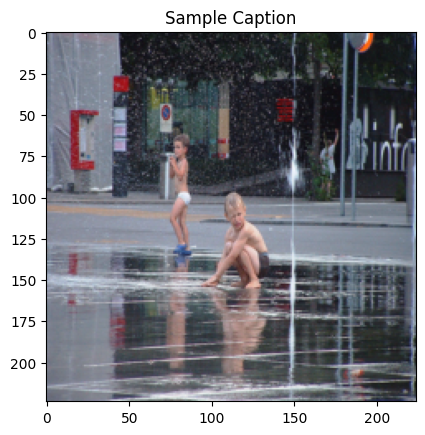

Evaluating:  37%|███▋      | 47/127 [00:12<00:23,  3.46it/s]

Sample 2:
 True: a little kid climbs a red mat on a festive carpet .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


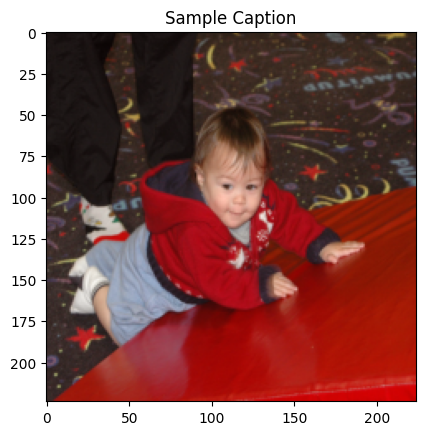

Evaluating:  83%|████████▎ | 105/127 [00:26<00:05,  4.14it/s]

Sample 3:
 True: a girl hangs over the seat of a swing in a playground .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


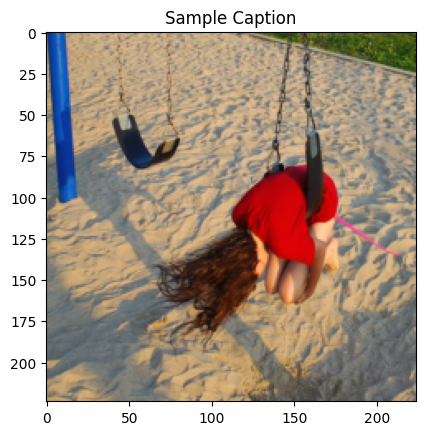

Evaluating: 100%|██████████| 127/127 [00:32<00:00,  3.94it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0413 | BLEU2: 0.1170 | BLEU3: 0.0689 | Cosine Similarity: 0.2211
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 4/25


Epoch 4: 100%|██████████| 506/506 [01:50<00:00,  4.58it/s]


✅ Epoch 4: Train Loss: 3.1460 | Val Loss: 3.0478
⏱️ Time: 2.31 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  20%|██        | 26/127 [00:06<00:24,  4.20it/s]

Sample 1:
 True: a boy on a bike rides around the neighborhood .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


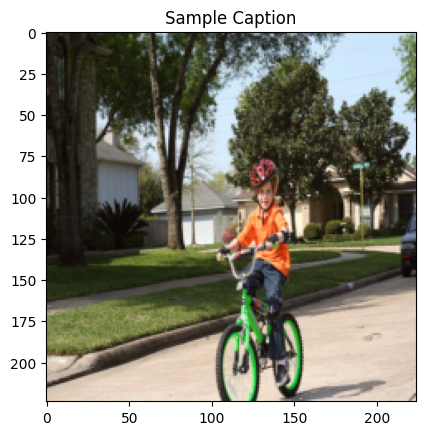

Evaluating:  38%|███▊      | 48/127 [00:11<00:18,  4.38it/s]

Sample 2:
 True: the dog does an obstacle course with his trainer .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


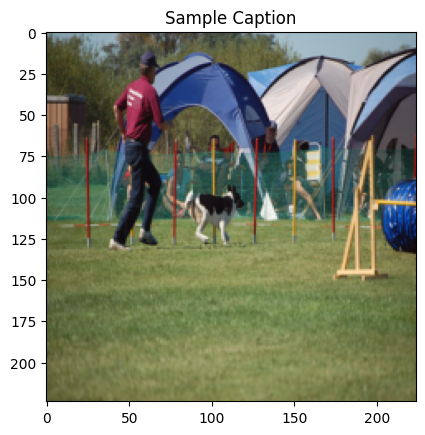

Evaluating:  61%|██████▏   | 78/127 [00:19<00:11,  4.23it/s]

Sample 3:
 True: a black dog leaps through the snow near a fence .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


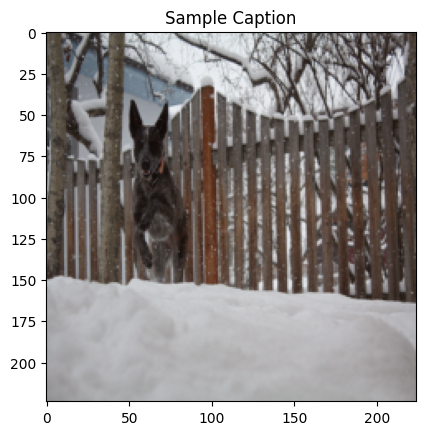

Evaluating: 100%|██████████| 127/127 [00:30<00:00,  4.11it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0424 | BLEU2: 0.1218 | BLEU3: 0.0710 | Cosine Similarity: 0.2875
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 5/25


Epoch 5: 100%|██████████| 506/506 [01:48<00:00,  4.65it/s]


✅ Epoch 5: Train Loss: 3.0278 | Val Loss: 2.9567
⏱️ Time: 2.28 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  19%|█▉        | 24/127 [00:05<00:23,  4.35it/s]

Sample 1:
 True: a brown and white dog playing on grass .
 Pred: <SOS> a dog is running through the grass . <EOS>


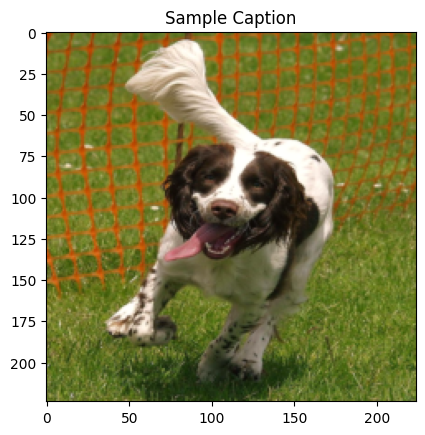

Evaluating:  20%|█▉        | 25/127 [00:06<00:31,  3.24it/s]

Sample 2:
 True: four snow dogs are pulled together in the snow .
 Pred: <SOS> a dog is running through the grass . <EOS>


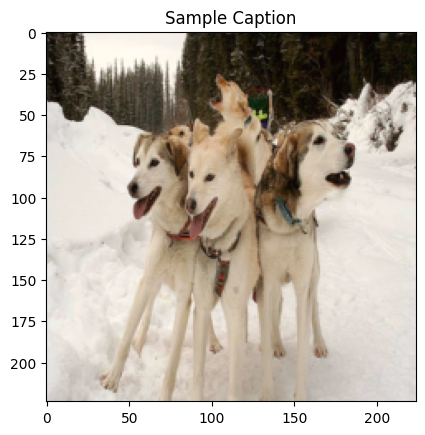

Evaluating:  79%|███████▊  | 100/127 [00:23<00:06,  4.33it/s]

Sample 3:
 True: a man is up in the air with one hand on a bull .
 Pred: <SOS> a man in a red shirt is standing on a <UNK> . <EOS>


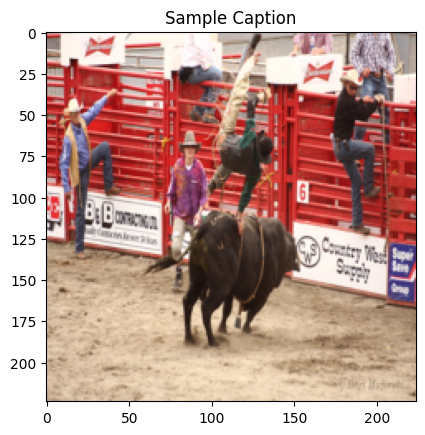

Evaluating: 100%|██████████| 127/127 [00:29<00:00,  4.27it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0418 | BLEU2: 0.1218 | BLEU3: 0.0703 | Cosine Similarity: 0.3024
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 6/25


Epoch 6: 100%|██████████| 506/506 [01:47<00:00,  4.70it/s]


✅ Epoch 6: Train Loss: 2.9357 | Val Loss: 2.8883
⏱️ Time: 2.25 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  61%|██████    | 77/127 [00:19<00:13,  3.78it/s]

Sample 1:
 True: people on bicycles riding through a group of onlookers .
 Pred: <SOS> a man in a red shirt and a black shirt is sitting on a bench . <EOS>


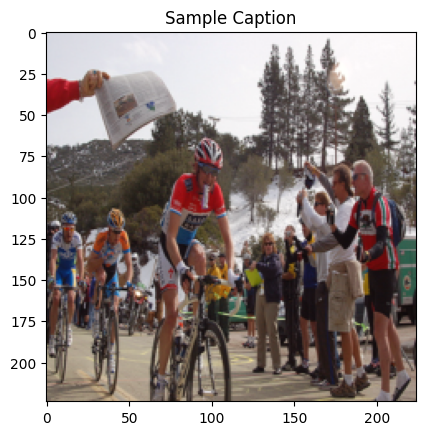

Evaluating:  67%|██████▋   | 85/127 [00:22<00:10,  3.97it/s]

Sample 2:
 True: a dog runs with another dog in the background holding a ball in its mouth .
 Pred: <SOS> a dog is running through the grass . <EOS>


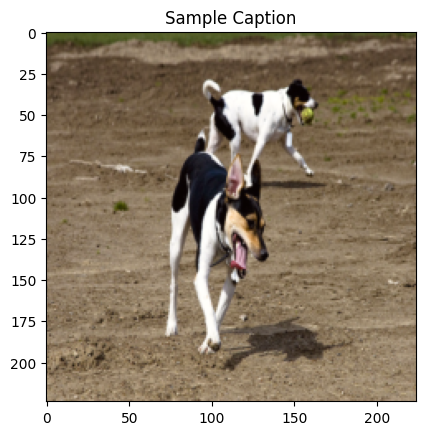

Evaluating:  79%|███████▊  | 100/127 [00:26<00:06,  3.87it/s]

Sample 3:
 True: a cowboy is thrown from the horse he was riding , while the <UNK> stands by with his hand on a yellow flag .
 Pred: <SOS> a man in a red shirt is standing on a bench in a park . <EOS>


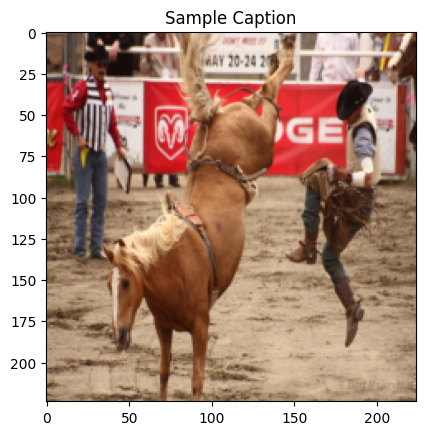

Evaluating: 100%|██████████| 127/127 [00:33<00:00,  3.83it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0215 | BLEU2: 0.0933 | BLEU3: 0.0416 | Cosine Similarity: 0.3120
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 7/25


Epoch 7: 100%|██████████| 506/506 [01:47<00:00,  4.69it/s]


✅ Epoch 7: Train Loss: 2.8622 | Val Loss: 2.8338
⏱️ Time: 2.26 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  17%|█▋        | 21/127 [00:05<00:27,  3.89it/s]

Sample 1:
 True: three individuals are posing on skis behind a " no skiing " sign .
 Pred: <SOS> a man in a blue shirt and a black shirt is sitting on a bench . <EOS>


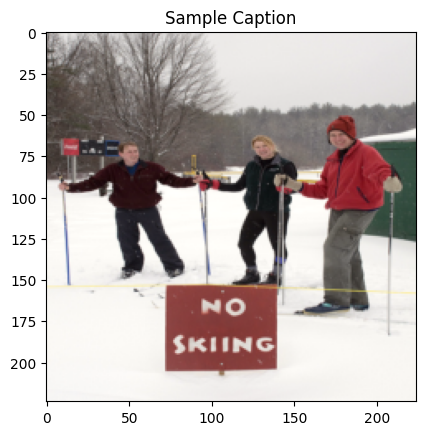

Evaluating:  74%|███████▍  | 94/127 [00:25<00:09,  3.60it/s]

Sample 2:
 True: woman swinging above water while holding a vine .
 Pred: <SOS> a man in a blue shirt is standing on a bench in a park . <EOS>


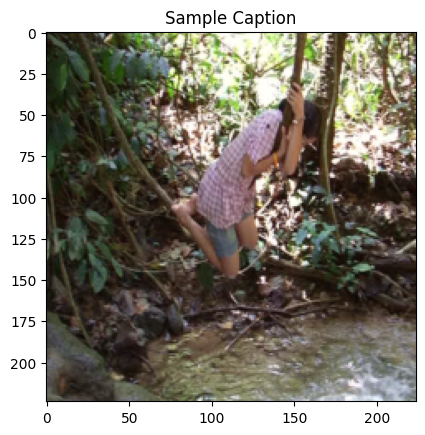

Evaluating:  87%|████████▋ | 110/127 [00:30<00:04,  3.70it/s]

Sample 3:
 True: three people in silver suits are riding bikes in the city .
 Pred: <SOS> a man in a blue shirt is standing on a bench in front of a building . <EOS>


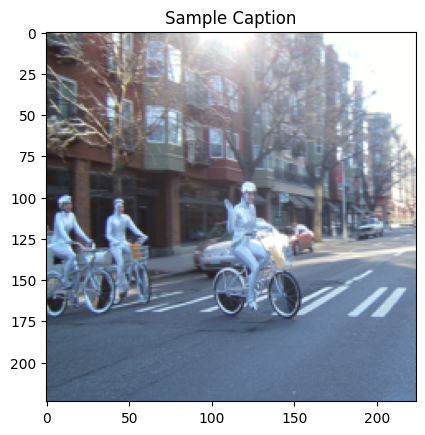

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.66it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0196 | BLEU2: 0.0893 | BLEU3: 0.0384 | Cosine Similarity: 0.2945
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 8/25


Epoch 8: 100%|██████████| 506/506 [01:47<00:00,  4.71it/s]


✅ Epoch 8: Train Loss: 2.7959 | Val Loss: 2.7911
⏱️ Time: 2.25 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  46%|████▋     | 59/127 [00:15<00:18,  3.63it/s]

Sample 1:
 True: a group of men playing against each other in a football match .
 Pred: <SOS> a man in a red shirt is standing in a field of water . <EOS>


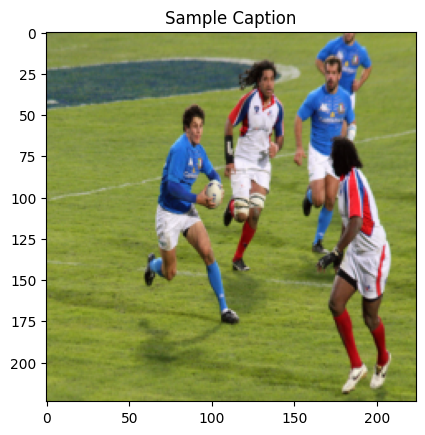

Evaluating:  64%|██████▍   | 81/127 [00:21<00:11,  3.87it/s]

Sample 2:
 True: two girls ride camels .
 Pred: <SOS> a dog is running through the grass . <EOS>


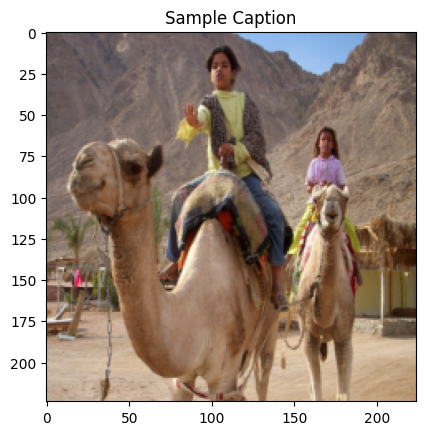

Evaluating:  88%|████████▊ | 112/127 [00:30<00:03,  3.85it/s]

Sample 3:
 True: a large and small dog interact in a grassy field .
 Pred: <SOS> a dog is running through the grass . <EOS>


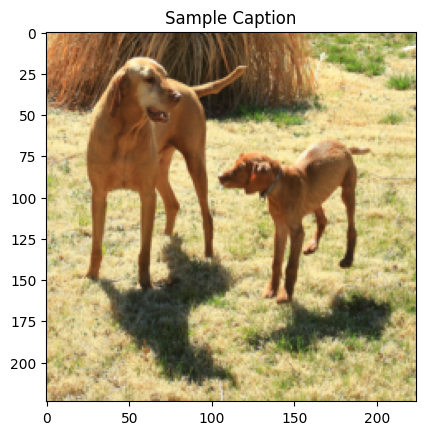

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.70it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0230 | BLEU2: 0.0900 | BLEU3: 0.0422 | Cosine Similarity: 0.3399
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 9/25


Epoch 9: 100%|██████████| 506/506 [01:49<00:00,  4.64it/s]


✅ Epoch 9: Train Loss: 2.7396 | Val Loss: 2.7509
⏱️ Time: 2.28 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  32%|███▏      | 41/127 [00:11<00:23,  3.66it/s]

Sample 1:
 True: a little girl wearing a black <UNK> is jumping in the air with water in the background .
 Pred: <SOS> a man in a blue shirt is riding a bike on a dirt bike . <EOS>


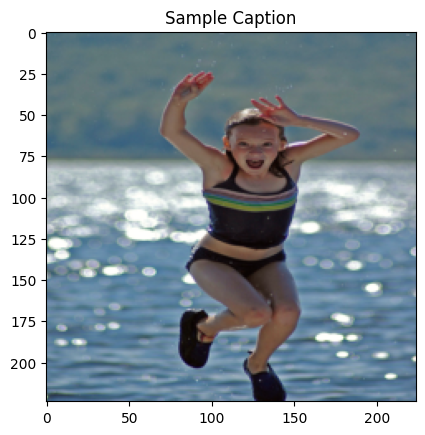

Evaluating:  61%|██████    | 77/127 [00:22<00:14,  3.52it/s]

Sample 2:
 True: a snowboarder is making a jump over a hillside with deep <UNK> located in the woods .
 Pred: <SOS> a man in a blue shirt is riding a bike on a dirt bike . <EOS>


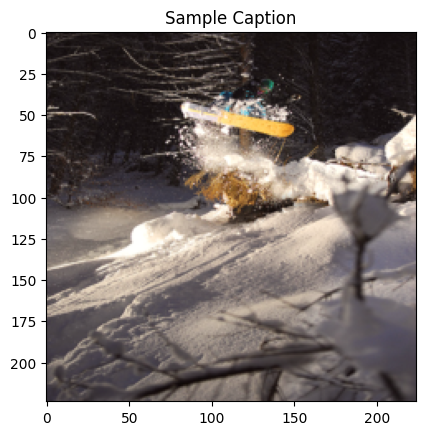

Evaluating:  69%|██████▉   | 88/127 [00:25<00:11,  3.43it/s]

Sample 3:
 True: a man with a backpack wearing a yellow <UNK> is riding a bicycle past red brick and stone wall .
 Pred: <SOS> a man in a red shirt and a woman in a red shirt and a woman in a red


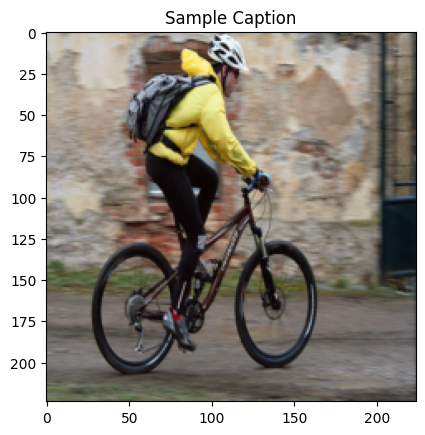

Evaluating: 100%|██████████| 127/127 [00:36<00:00,  3.48it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0236 | BLEU2: 0.0869 | BLEU3: 0.0426 | Cosine Similarity: 0.3251
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 10/25


Epoch 10: 100%|██████████| 506/506 [01:51<00:00,  4.56it/s]


✅ Epoch 10: Train Loss: 2.6860 | Val Loss: 2.7137
⏱️ Time: 2.32 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  31%|███       | 39/127 [00:10<00:23,  3.77it/s]

Sample 1:
 True: a black dog jumps over hurdles .
 Pred: <SOS> a man in a red shirt is standing on a bench with a man in a red shirt and


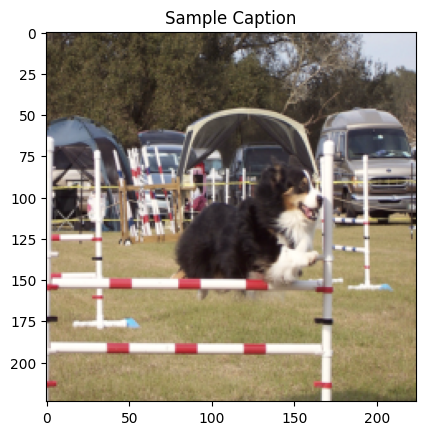

Evaluating:  95%|█████████▌| 121/127 [00:33<00:01,  3.63it/s]

Sample 2:
 True: two people watch a dog run along a blue cloth with numbers on it .
 Pred: <SOS> a man in a blue shirt is riding a bike on a dirt track . <EOS>


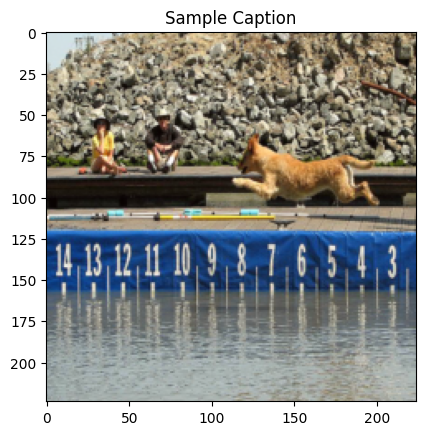

Evaluating:  99%|█████████▉| 126/127 [00:35<00:00,  3.56it/s]

Sample 3:
 True: a woman behind a <UNK> wall is writing
 Pred: <SOS> a man in a black shirt and a black hat and a woman in a red shirt and a


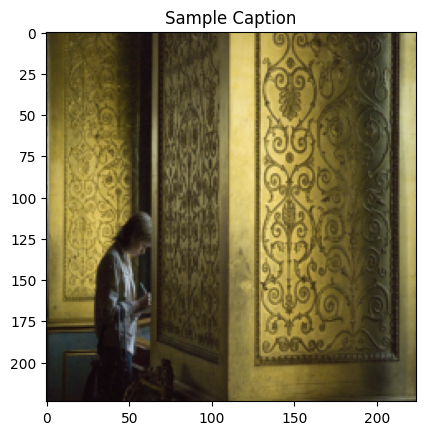

Evaluating: 100%|██████████| 127/127 [00:35<00:00,  3.58it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0227 | BLEU2: 0.0890 | BLEU3: 0.0423 | Cosine Similarity: 0.3392
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 11/25


Epoch 11: 100%|██████████| 506/506 [01:47<00:00,  4.73it/s]


✅ Epoch 11: Train Loss: 2.6369 | Val Loss: 2.6862
⏱️ Time: 2.24 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  34%|███▍      | 43/127 [00:11<00:22,  3.77it/s]

Sample 1:
 True: the large brown dog is chasing after the little brown dog .
 Pred: <SOS> a dog is running through a field . <EOS>


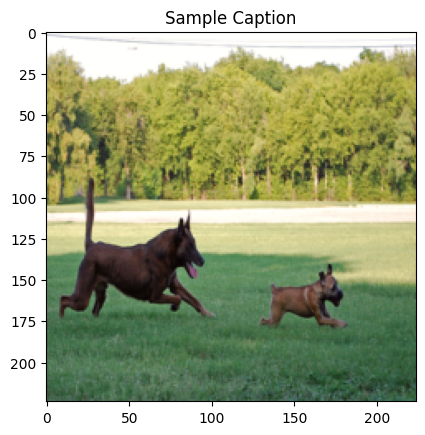

Evaluating:  39%|███▊      | 49/127 [00:13<00:21,  3.59it/s]

Sample 2:
 True: the man on the bike just <UNK> riding through some mud .
 Pred: <SOS> a man in a red shirt is standing on a bench with a man in a black shirt and


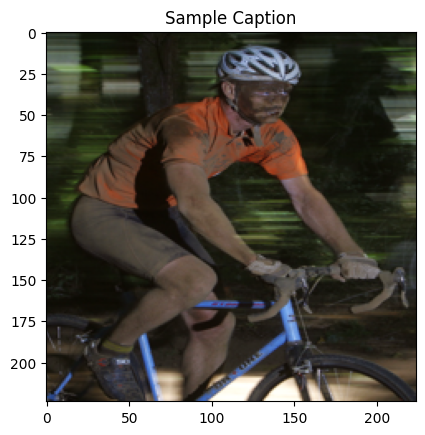

Evaluating:  98%|█████████▊| 125/127 [00:34<00:00,  3.85it/s]

Sample 3:
 True: girls in swimsuits jumping into water from behind
 Pred: <SOS> a group of people are standing on a bench in front of a building . <EOS>


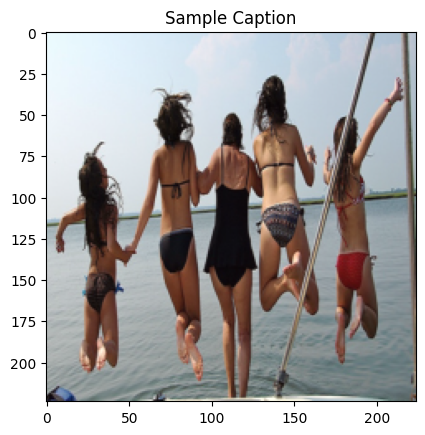

Evaluating: 100%|██████████| 127/127 [00:35<00:00,  3.61it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0215 | BLEU2: 0.0906 | BLEU3: 0.0412 | Cosine Similarity: 0.3606
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 12/25


Epoch 12: 100%|██████████| 506/506 [01:50<00:00,  4.57it/s]


✅ Epoch 12: Train Loss: 2.5925 | Val Loss: 2.6616
⏱️ Time: 2.30 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  37%|███▋      | 47/127 [00:12<00:19,  4.07it/s]

Sample 1:
 True: a bike rider jumping off his bike , doing a trick
 Pred: <SOS> a man is riding a bike on a dirt track . <EOS>


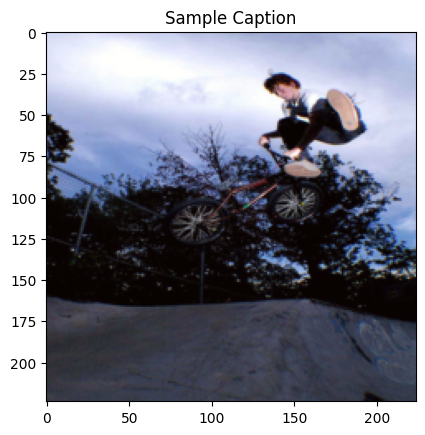

Evaluating:  55%|█████▌    | 70/127 [00:18<00:14,  3.92it/s]

Sample 2:
 True: people inside a shop at night while other people walk around outside .
 Pred: <SOS> a man in a red shirt is standing on a bench with a man in a black shirt .


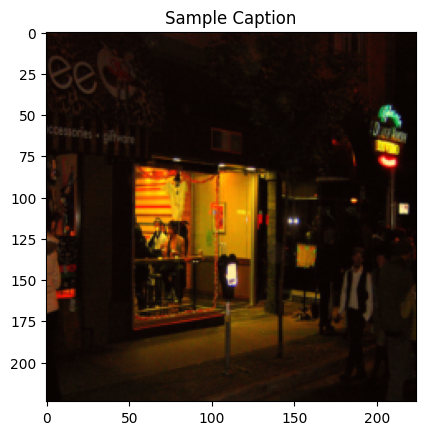

Evaluating:  66%|██████▌   | 84/127 [00:22<00:10,  4.01it/s]

Sample 3:
 True: two people play a game at a carnival .
 Pred: <SOS> a man in a red shirt and a woman in a red shirt and a woman in a red


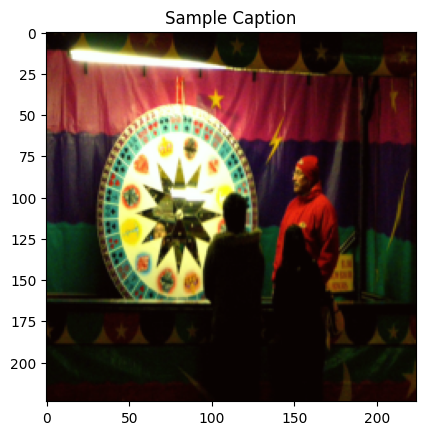

Evaluating: 100%|██████████| 127/127 [00:33<00:00,  3.84it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0241 | BLEU2: 0.0960 | BLEU3: 0.0456 | Cosine Similarity: 0.3658
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 13/25


Epoch 13: 100%|██████████| 506/506 [01:51<00:00,  4.54it/s]


✅ Epoch 13: Train Loss: 2.5510 | Val Loss: 2.6416
⏱️ Time: 2.32 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  23%|██▎       | 29/127 [00:07<00:24,  4.04it/s]

Sample 1:
 True: the man wearing the <UNK> <UNK> suit is dancing with the little girl in the pink top .
 Pred: <SOS> a man in a red shirt is standing on a bench with a man in a black shirt .


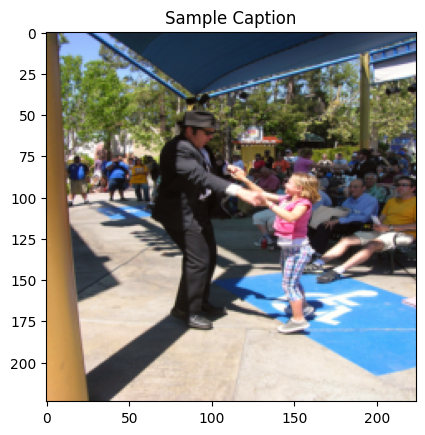

Evaluating:  35%|███▌      | 45/127 [00:12<00:21,  3.83it/s]

Sample 2:
 True: a woman with a baby in a backpack , standing in a <UNK> .
 Pred: <SOS> a man in a blue shirt is jumping over a large rock . <EOS>


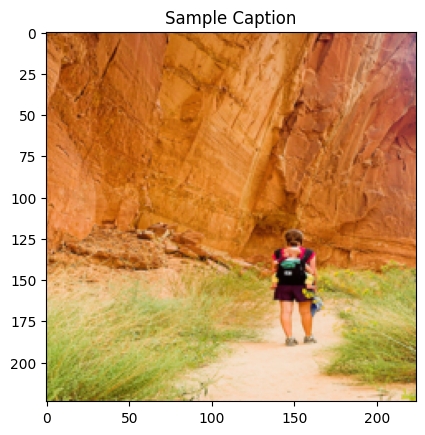

Evaluating:  98%|█████████▊| 124/127 [00:33<00:00,  3.90it/s]

Sample 3:
 True: a young girl in a bathing suit and pigtails crosses her arms .
 Pred: <SOS> a boy in a red shirt is running through a field . <EOS>


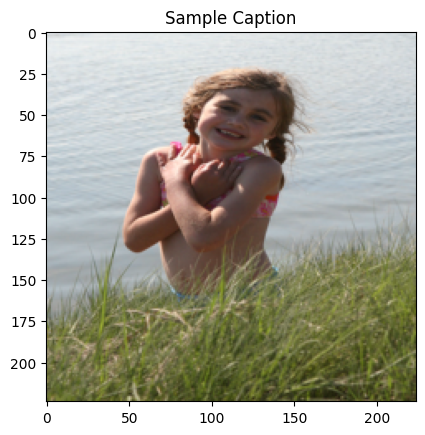

Evaluating: 100%|██████████| 127/127 [00:33<00:00,  3.75it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0266 | BLEU2: 0.0964 | BLEU3: 0.0479 | Cosine Similarity: 0.3614
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 14/25


Epoch 14: 100%|██████████| 506/506 [01:47<00:00,  4.69it/s]


✅ Epoch 14: Train Loss: 2.5125 | Val Loss: 2.6199
⏱️ Time: 2.25 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:   7%|▋         | 9/127 [00:02<00:32,  3.63it/s]

Sample 1:
 True: a little boy sits on a slide on the playground .
 Pred: <SOS> a young girl in a pink dress is playing with a red toy . <EOS>


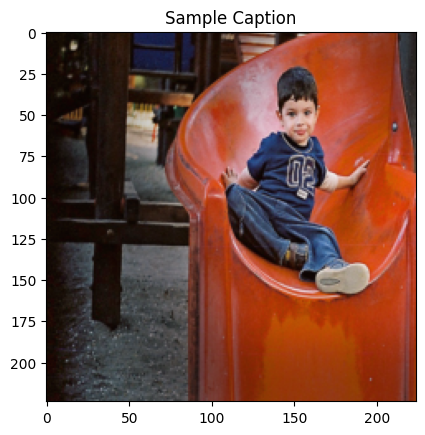

Evaluating:  11%|█         | 14/127 [00:04<00:32,  3.44it/s]

Sample 2:
 True: a gray dog is looking at a ball in the air .
 Pred: <SOS> a dog is running through a field . <EOS>


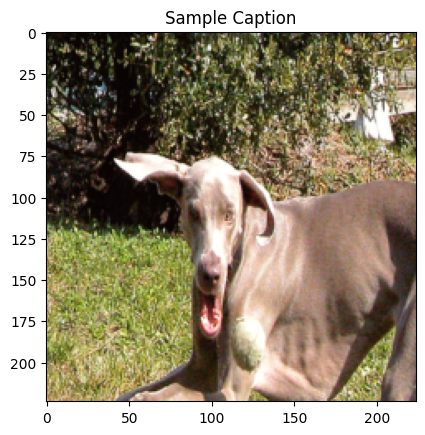

Evaluating:  57%|█████▋    | 73/127 [00:20<00:15,  3.49it/s]

Sample 3:
 True: the man and woman show off their matching skull tattoos .
 Pred: <SOS> a man in a red shirt and a woman in a red shirt and a woman in a red


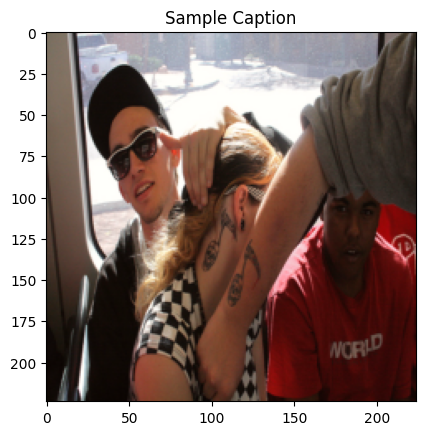

Evaluating: 100%|██████████| 127/127 [00:35<00:00,  3.60it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0269 | BLEU2: 0.0944 | BLEU3: 0.0477 | Cosine Similarity: 0.3678
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 15/25


Epoch 15: 100%|██████████| 506/506 [01:47<00:00,  4.71it/s]


✅ Epoch 15: Train Loss: 2.4772 | Val Loss: 2.6261
⏱️ Time: 2.25 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  16%|█▌        | 20/127 [00:05<00:28,  3.70it/s]

Sample 1:
 True: two boys in running clothes stretching .
 Pred: <SOS> a man in a red shirt is standing in front of a crowd of people . <EOS>


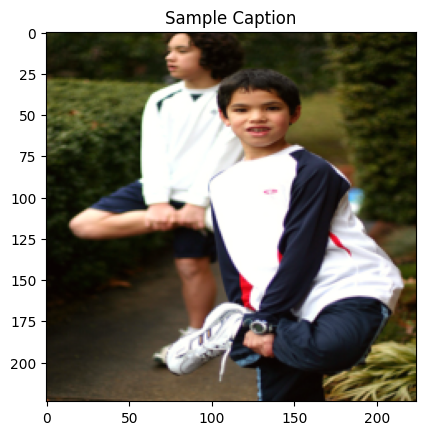

Evaluating:  17%|█▋        | 22/127 [00:06<00:35,  2.97it/s]

Sample 2:
 True: a little girl walking down the sidewalk .
 Pred: <SOS> a man in a red shirt is riding a bike on a dirt track . <EOS>


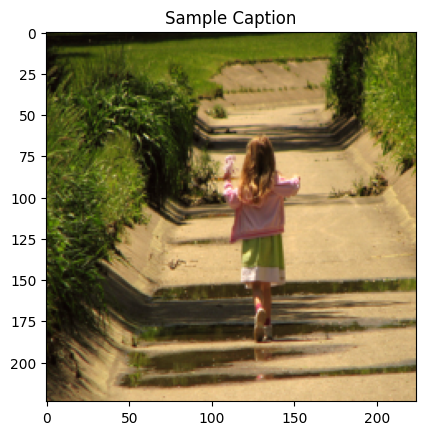

Evaluating:  66%|██████▌   | 84/127 [00:23<00:11,  3.81it/s]

Sample 3:
 True: dog with a red collar running in the snow .
 Pred: <SOS> a man is standing on a rock in the snow . <EOS>


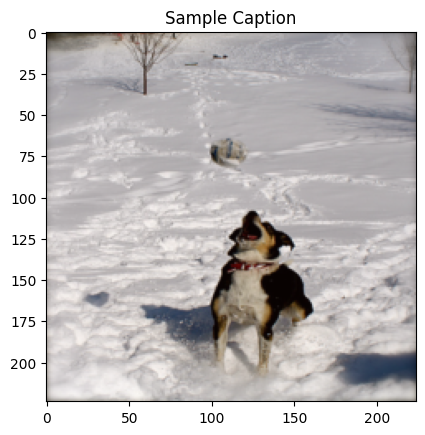

Evaluating: 100%|██████████| 127/127 [00:35<00:00,  3.62it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0257 | BLEU2: 0.0946 | BLEU3: 0.0461 | Cosine Similarity: 0.3401
⚠️ No improvement. Patience left: 4

📘 Epoch 16/25


Epoch 16: 100%|██████████| 506/506 [01:51<00:00,  4.53it/s]


✅ Epoch 16: Train Loss: 2.4432 | Val Loss: 2.5934
⏱️ Time: 2.33 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  35%|███▍      | 44/127 [00:12<00:23,  3.55it/s]

Sample 1:
 True: a young blonde woman in black smiles under her black umbrella .
 Pred: <SOS> a man in a blue shirt and a woman in a black shirt and a woman in a red


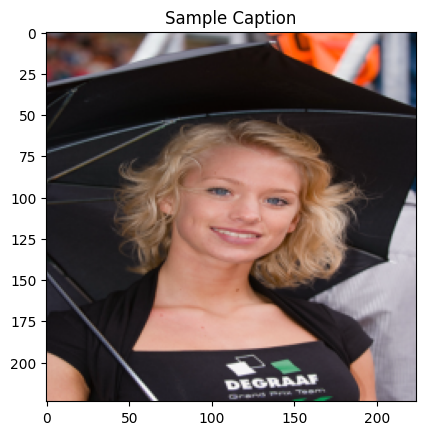

Evaluating:  57%|█████▋    | 73/127 [00:20<00:15,  3.44it/s]

Sample 2:
 True: a group of people stand together and look at the camera .
 Pred: <SOS> a man in a black shirt and a woman in a black shirt and a woman in a red


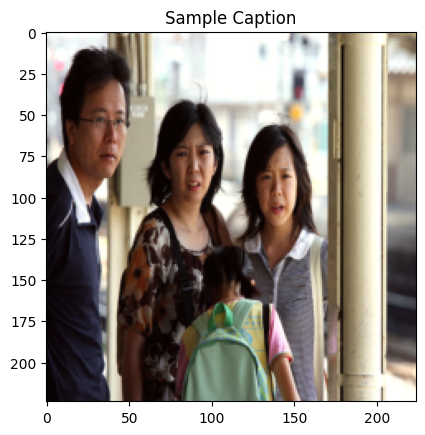

Evaluating:  78%|███████▊  | 99/127 [00:28<00:08,  3.49it/s]

Sample 3:
 True: two dogs are jumping on an empty beach with waves .
 Pred: <SOS> a dog is running through the water . <EOS>


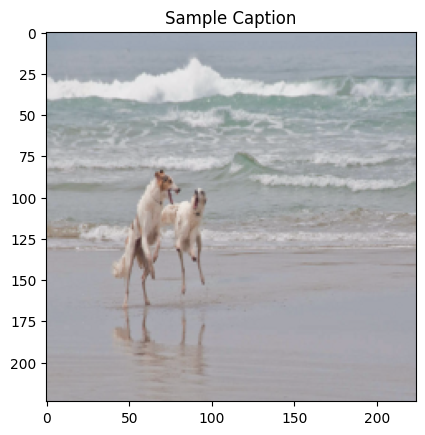

Evaluating: 100%|██████████| 127/127 [00:36<00:00,  3.51it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0261 | BLEU2: 0.0950 | BLEU3: 0.0474 | Cosine Similarity: 0.3677
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 17/25


Epoch 17: 100%|██████████| 506/506 [01:49<00:00,  4.61it/s]


✅ Epoch 17: Train Loss: 2.4120 | Val Loss: 2.5797
⏱️ Time: 2.30 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  18%|█▊        | 23/127 [00:06<00:28,  3.71it/s]

Sample 1:
 True: a man and a woman sit on a bench outdoors .
 Pred: <SOS> a man in a black shirt and a woman in a red shirt and a woman in a red


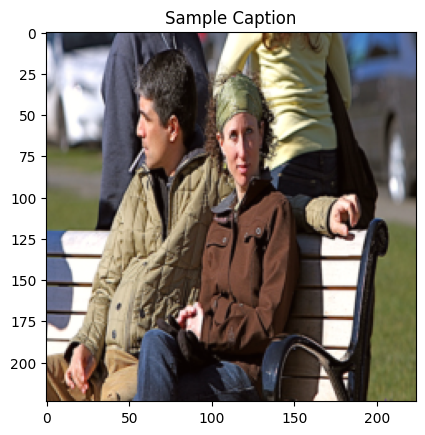

Evaluating:  51%|█████     | 65/127 [00:18<00:17,  3.59it/s]

Sample 2:
 True: a tan dog running through the grass with the background blurry
 Pred: <SOS> a brown dog is running through a field of grass . <EOS>


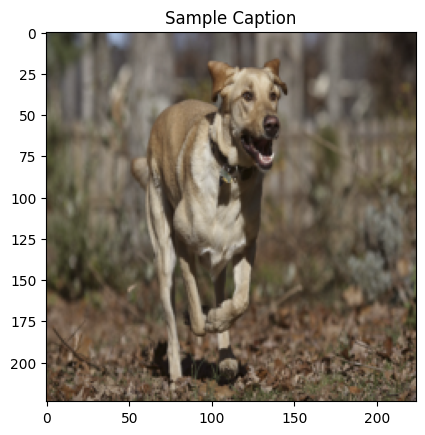

Evaluating:  90%|████████▉ | 114/127 [00:31<00:03,  3.79it/s]

Sample 3:
 True: a white puppy is carrying a black bird in its mouth .
 Pred: <SOS> a dog is running through a field . <EOS>


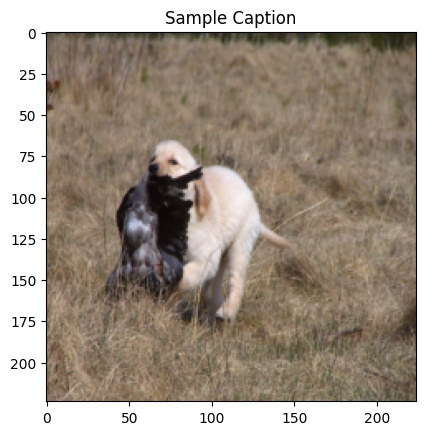

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.64it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0306 | BLEU2: 0.1025 | BLEU3: 0.0535 | Cosine Similarity: 0.3841
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 18/25


Epoch 18: 100%|██████████| 506/506 [01:47<00:00,  4.69it/s]


✅ Epoch 18: Train Loss: 2.3814 | Val Loss: 2.5730
⏱️ Time: 2.27 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  24%|██▎       | 30/127 [00:08<00:25,  3.88it/s]

Sample 1:
 True: two dogs pass each other near some water .
 Pred: <SOS> a black dog is running through the grass . <EOS>


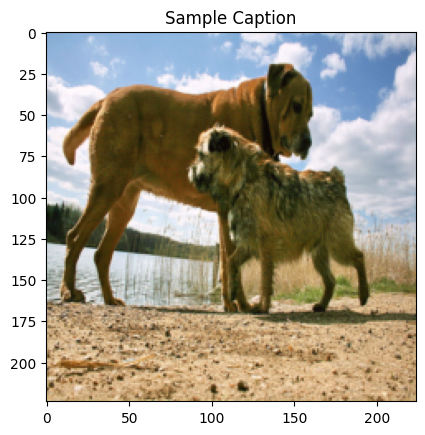

Evaluating:  39%|███▊      | 49/127 [00:13<00:20,  3.81it/s]

Sample 2:
 True: the man is wearing a straw hat and smoking a cigarette .
 Pred: <SOS> a man in a black shirt and a woman in a black shirt and a woman in a red


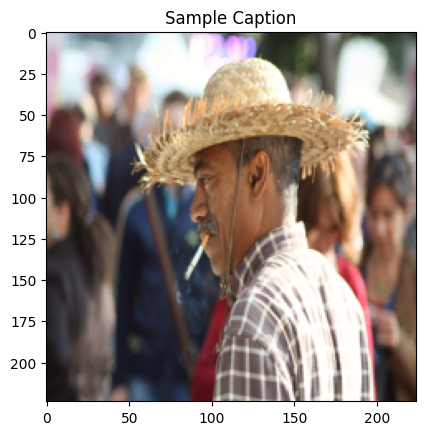

Evaluating:  43%|████▎     | 55/127 [00:15<00:20,  3.59it/s]

Sample 3:
 True: a biker <UNK> waits as his friend bikes ahead of him .
 Pred: <SOS> a man in a red shirt is riding a bike on a dirt road . <EOS>


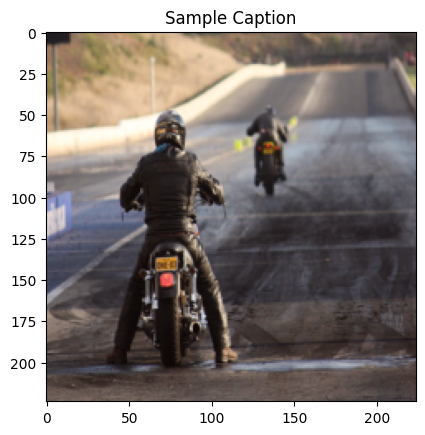

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.65it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0293 | BLEU2: 0.1013 | BLEU3: 0.0518 | Cosine Similarity: 0.3878
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 19/25


Epoch 19: 100%|██████████| 506/506 [01:54<00:00,  4.41it/s]


✅ Epoch 19: Train Loss: 2.3526 | Val Loss: 2.5643
⏱️ Time: 2.38 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  57%|█████▋    | 72/127 [00:20<00:15,  3.60it/s]

Sample 1:
 True: a teenage male grinds on his skateboard .
 Pred: <SOS> a man in a black shirt and a woman in a black shirt and a woman in a black


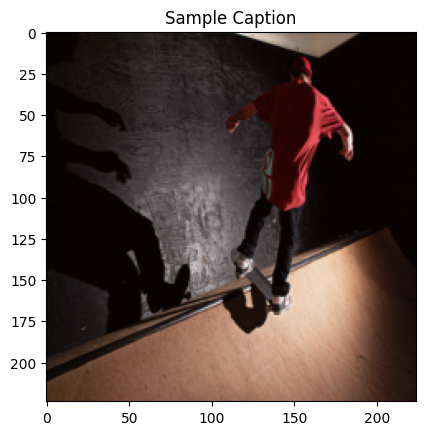

Evaluating:  84%|████████▍ | 107/127 [00:30<00:05,  3.58it/s]

Sample 2:
 True: the man wearing the white shirt takes a picture of the man in the blue shirt with the two dogs .
 Pred: <SOS> a black dog is running through a grassy field . <EOS>


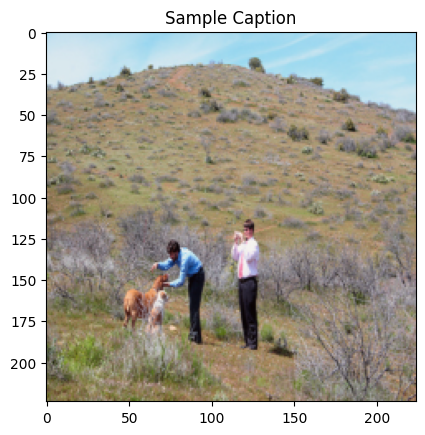

Evaluating:  88%|████████▊ | 112/127 [00:31<00:04,  3.57it/s]

Sample 3:
 True: a man wearing a yellow sweater playing with a black dog in a grassy field
 Pred: <SOS> a man and a woman are playing with a dog on a beach . <EOS>


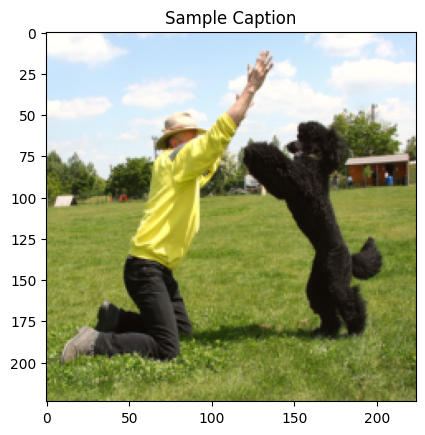

Evaluating: 100%|██████████| 127/127 [00:35<00:00,  3.54it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0256 | BLEU2: 0.0942 | BLEU3: 0.0465 | Cosine Similarity: 0.3773
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 20/25


Epoch 20: 100%|██████████| 506/506 [01:49<00:00,  4.61it/s]


✅ Epoch 20: Train Loss: 2.3247 | Val Loss: 2.5708
⏱️ Time: 2.29 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  17%|█▋        | 21/127 [00:05<00:27,  3.89it/s]

Sample 1:
 True: a child sitting on a rock formation .
 Pred: <SOS> a man is riding a bike on a dirt road . <EOS>


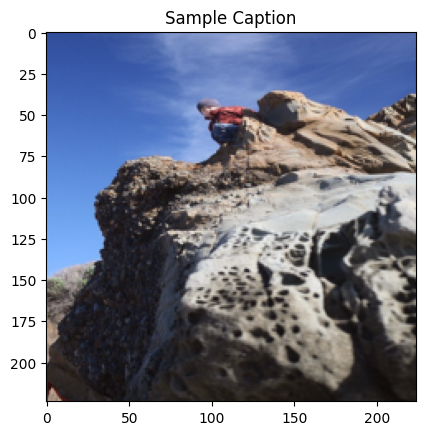

Evaluating:  24%|██▎       | 30/127 [00:08<00:25,  3.82it/s]

Sample 2:
 True: a group of people gather for a picture while a woman stands on a post and takes the picture .
 Pred: <SOS> a man in a red shirt is riding a bike on a dirt road . <EOS>


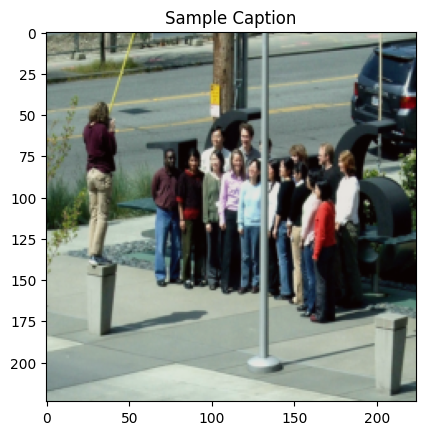

Evaluating:  61%|██████▏   | 78/127 [00:21<00:13,  3.76it/s]

Sample 3:
 True: a bunch of dogs on a beach .
 Pred: <SOS> a man is standing on a rock in the snow . <EOS>


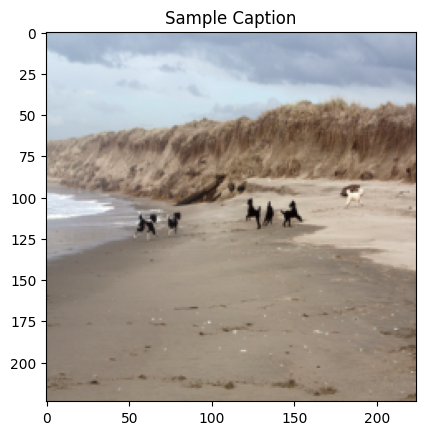

Evaluating: 100%|██████████| 127/127 [00:33<00:00,  3.74it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0289 | BLEU2: 0.1015 | BLEU3: 0.0514 | Cosine Similarity: 0.3816
⚠️ No improvement. Patience left: 4

📘 Epoch 21/25


Epoch 21: 100%|██████████| 506/506 [01:50<00:00,  4.59it/s]


✅ Epoch 21: Train Loss: 2.2974 | Val Loss: 2.5505
⏱️ Time: 2.30 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  37%|███▋      | 47/127 [00:12<00:21,  3.78it/s]

Sample 1:
 True: a man is performing a jumping <UNK> on his bicycle .
 Pred: <SOS> a man is riding a bike on a dirt road . <EOS>


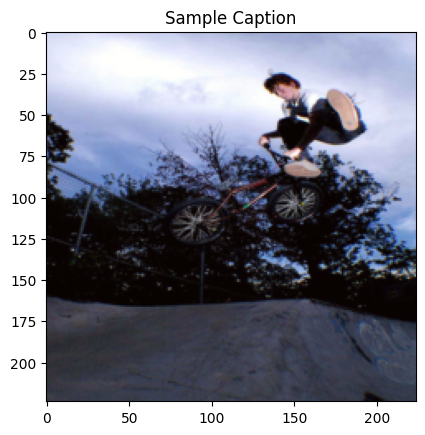

Evaluating:  39%|███▊      | 49/127 [00:13<00:25,  3.10it/s]

Sample 2:
 True: two people are driving a blue jet ski , leaving a trail of water in the air .
 Pred: <SOS> a man in a blue jacket is riding a dirt bike through the snow . <EOS>


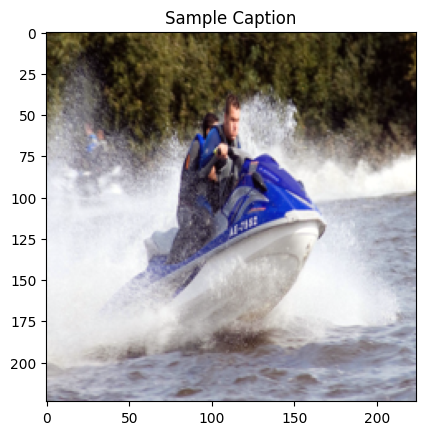

Evaluating:  76%|███████▋  | 97/127 [00:26<00:07,  3.81it/s]

Sample 3:
 True: two <UNK> swimming in the water .
 Pred: <SOS> a dog is running through the snow . <EOS>


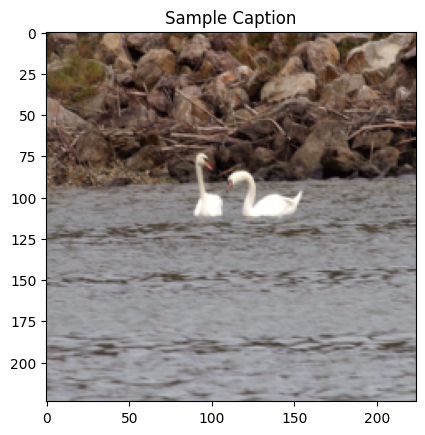

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.73it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0305 | BLEU2: 0.1026 | BLEU3: 0.0539 | Cosine Similarity: 0.3903
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth

📘 Epoch 22/25


Epoch 22: 100%|██████████| 506/506 [01:49<00:00,  4.61it/s]


✅ Epoch 22: Train Loss: 2.2708 | Val Loss: 2.5610
⏱️ Time: 2.29 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  10%|█         | 13/127 [00:03<00:30,  3.73it/s]

Sample 1:
 True: child in a restaurant posing with a paper mask
 Pred: <SOS> a man in a black shirt and a woman in a black shirt and a woman in a red


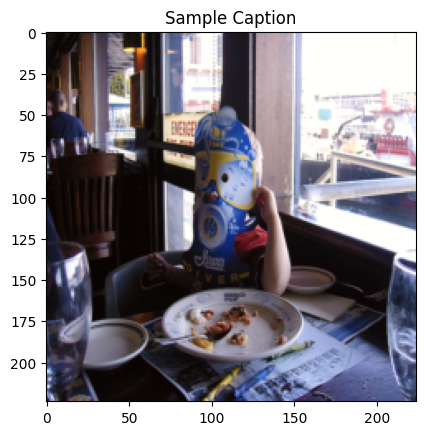

Evaluating:  68%|██████▊   | 86/127 [00:23<00:10,  3.96it/s]

Sample 2:
 True: a woman in an orange athletic outfit playing tennis
 Pred: <SOS> a young girl in a pink shirt and blue jeans is holding a <UNK> . <EOS>


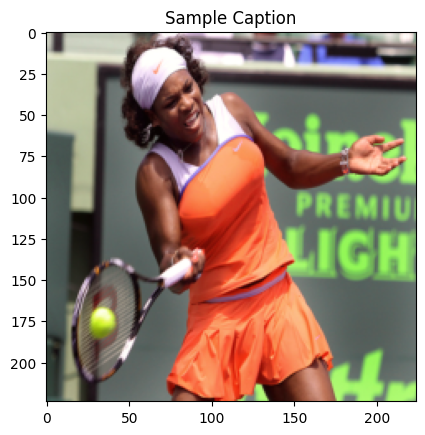

Evaluating:  76%|███████▋  | 97/127 [00:26<00:08,  3.73it/s]

Sample 3:
 True: a man is sitting on a bench , cooking some food .
 Pred: <SOS> a boy in a blue shirt is jumping off a ramp . <EOS>


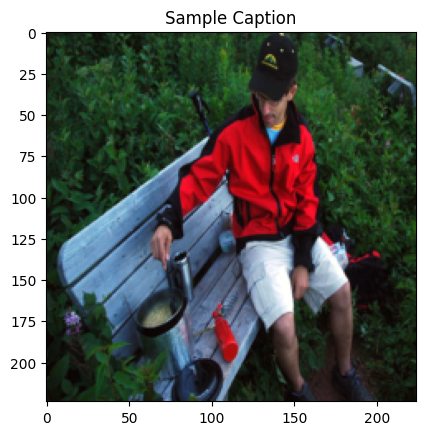

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.65it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0231 | BLEU2: 0.0917 | BLEU3: 0.0436 | Cosine Similarity: 0.3872
⚠️ No improvement. Patience left: 4

📘 Epoch 23/25


Epoch 23: 100%|██████████| 506/506 [01:48<00:00,  4.66it/s]


✅ Epoch 23: Train Loss: 2.2433 | Val Loss: 2.5633
⏱️ Time: 2.28 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  44%|████▍     | 56/127 [00:14<00:17,  4.05it/s]

Sample 1:
 True: man with mask on raises hand .
 Pred: <SOS> a man and a woman are sitting on a bench . <EOS>


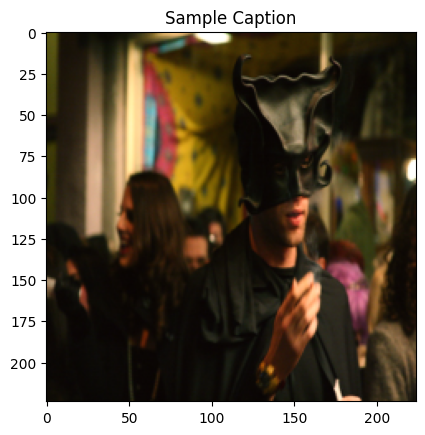

Evaluating:  69%|██████▉   | 88/127 [00:22<00:09,  4.12it/s]

Sample 2:
 True: a skateboarder in the air in front of <UNK> .
 Pred: <SOS> a man in a red shirt is riding a bike on a dirt road . <EOS>


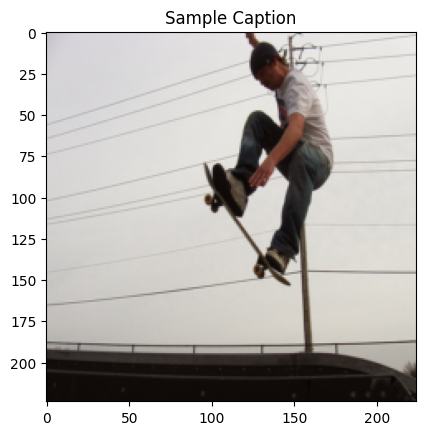

Evaluating:  77%|███████▋  | 98/127 [00:24<00:06,  4.19it/s]

Sample 3:
 True: girls dance in colorful outfits .
 Pred: <SOS> a man in a red shirt is standing in front of a <UNK> <UNK> . <EOS>


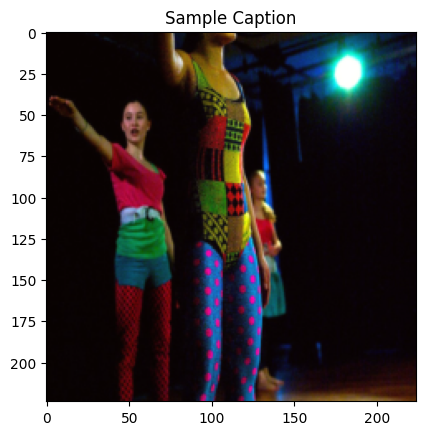

Evaluating: 100%|██████████| 127/127 [00:32<00:00,  3.92it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0271 | BLEU2: 0.1022 | BLEU3: 0.0503 | Cosine Similarity: 0.4157
⚠️ No improvement. Patience left: 3

📘 Epoch 24/25


Epoch 24: 100%|██████████| 506/506 [01:50<00:00,  4.58it/s]


✅ Epoch 24: Train Loss: 2.2179 | Val Loss: 2.5615
⏱️ Time: 2.31 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  39%|███▉      | 50/127 [00:13<00:20,  3.81it/s]

Sample 1:
 True: a little girl in a pink leotard is jumping and landing in a <UNK> <UNK> on a blue bed .
 Pred: <SOS> a young girl in a pink dress is running on the beach . <EOS>


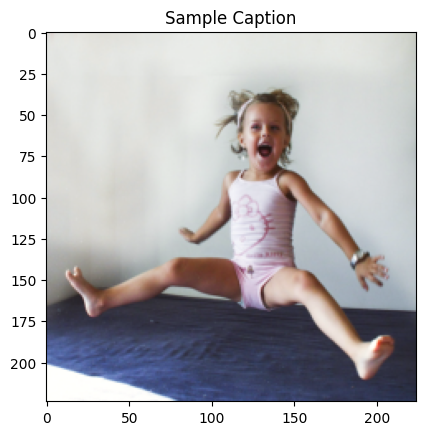

Evaluating:  75%|███████▍  | 95/127 [00:26<00:08,  3.82it/s]

Sample 2:
 True: a surfer catches a <UNK> wave .
 Pred: <SOS> a man is surfing on a wave . <EOS>


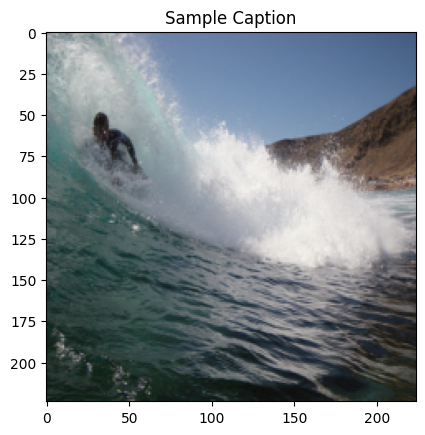

Evaluating:  77%|███████▋  | 98/127 [00:27<00:08,  3.49it/s]

Sample 3:
 True: two cars race down a track .
 Pred: <SOS> a man in a red shirt is riding a bicycle on a dirt track . <EOS>


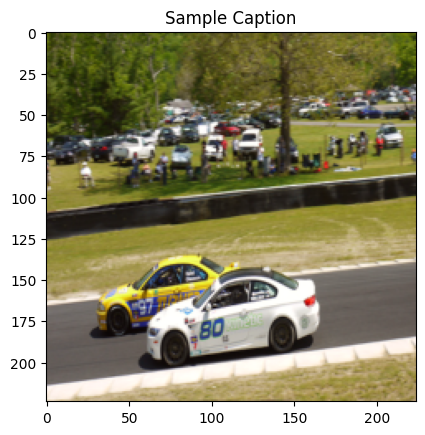

Evaluating: 100%|██████████| 127/127 [00:34<00:00,  3.63it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0286 | BLEU2: 0.0988 | BLEU3: 0.0505 | Cosine Similarity: 0.3906
⚠️ No improvement. Patience left: 2

📘 Epoch 25/25


Epoch 25: 100%|██████████| 506/506 [01:50<00:00,  4.59it/s]


✅ Epoch 25: Train Loss: 2.1934 | Val Loss: 2.5470
⏱️ Time: 2.29 min
🔍 Sample captions with BLEU & Cosine Similarity:


Evaluating:  75%|███████▍  | 95/127 [00:25<00:08,  3.85it/s]

Sample 1:
 True: a girl , in a black shirt and hot pink pants , is about to hit a tennis ball on the court .
 Pred: <SOS> a man in a red shirt and a woman in a red shirt and a woman in a black


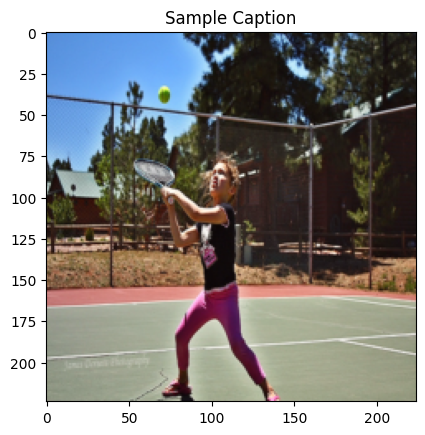

Evaluating:  76%|███████▋  | 97/127 [00:25<00:09,  3.23it/s]

Sample 2:
 True: a little baby on a tricycle <UNK> to not be wearing <UNK> clothes .
 Pred: <SOS> a young girl in a pink bathing suit is jumping into a pool . <EOS>


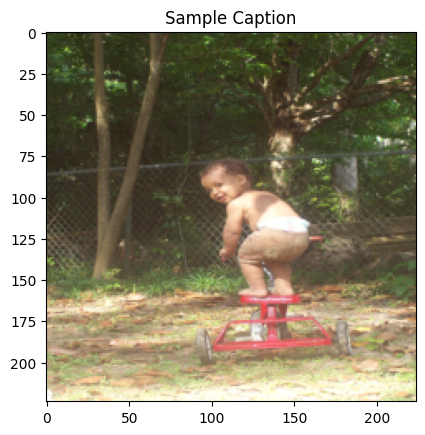

Evaluating:  87%|████████▋ | 111/127 [00:29<00:04,  3.93it/s]

Sample 3:
 True: a rock climber
 Pred: <SOS> a dog is running through the snow . <EOS>


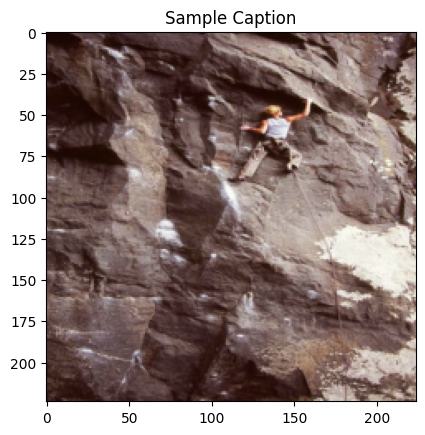

Evaluating: 100%|██████████| 127/127 [00:33<00:00,  3.75it/s]


🚀 Averages on FULL VAL SET -> BLEU: 0.0281 | BLEU2: 0.1005 | BLEU3: 0.0510 | Cosine Similarity: 0.3967
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_best_model.pth
💾 Saved checkpoint: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_final_model.pth

📦 Final checkpoint saved at: /workspace/image-captioning/artifacts/flickr8k/scratchcnn_lstm_final_model.pth
🎯 Best Epoch: 25 | Best Val Loss: 2.5470
✅ Total Training Time: 73.33 min
📄 Metadata saved: /workspace/image-captioning/outputs/flickr8k/scratchcnn_lstm_training_metadata.json

✅ Loss curve saved to: /workspace/image-captioning/outputs/flickr8k/scratchcnn_lstm_loss_curve.png


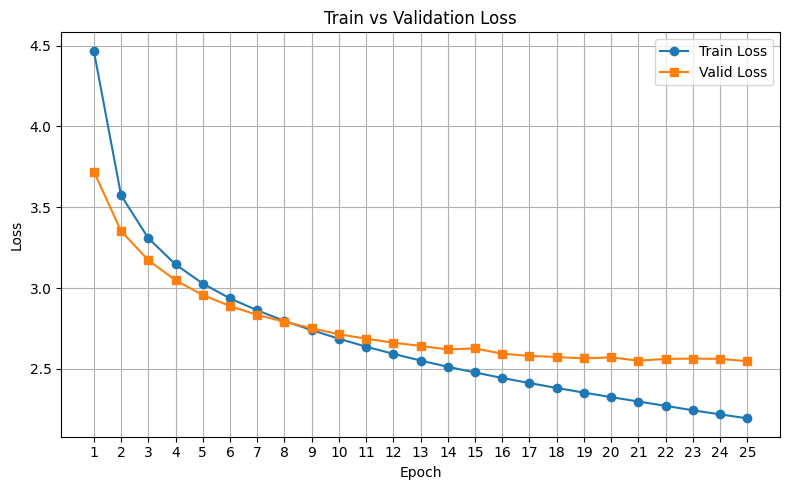

✅ BLEU curve saved to: /workspace/image-captioning/outputs/flickr8k/scratchcnn_lstm_bleu_curve.png


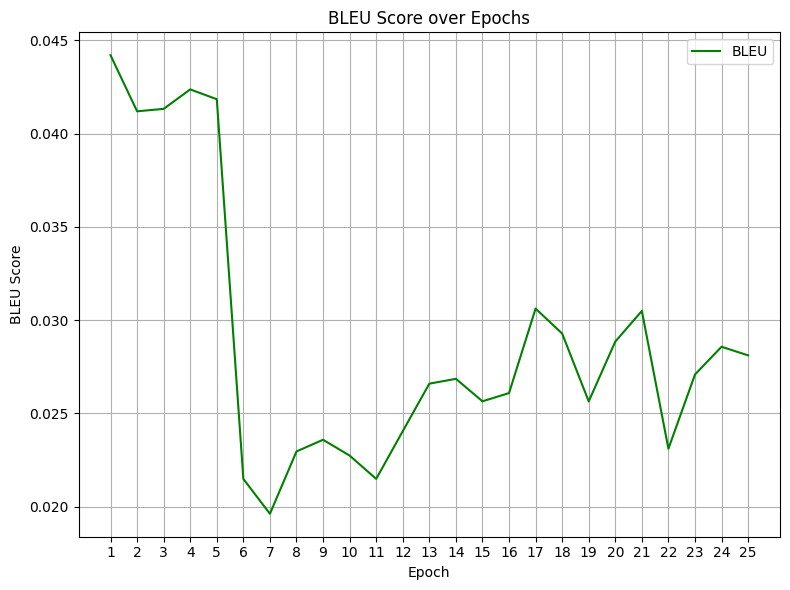

✅ BLEU curve saved to: /workspace/image-captioning/outputs/flickr8k/scratchcnn_lstm_all_metrics_curve.png


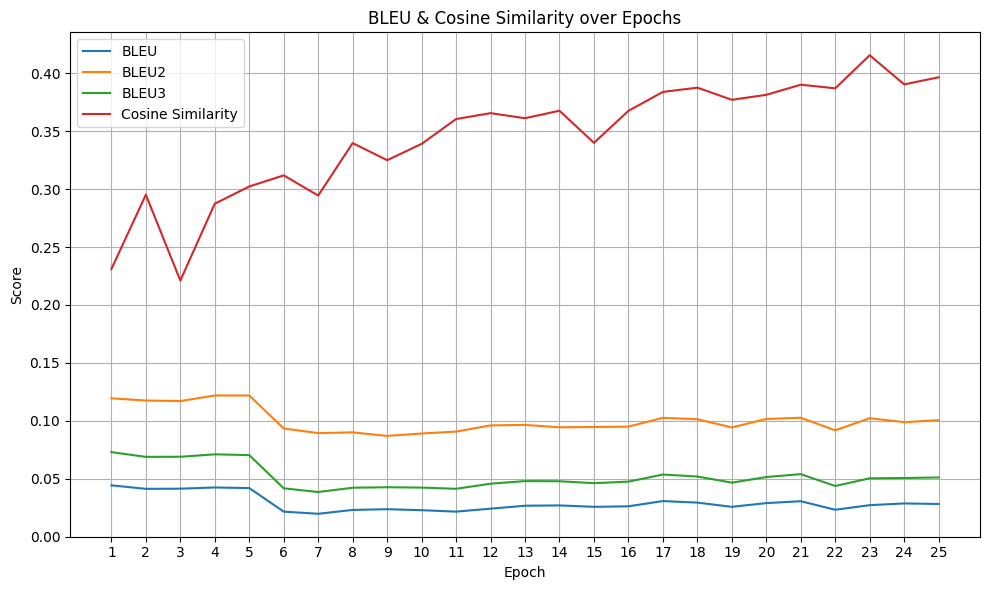

📊 Training log CSV saved to: /workspace/image-captioning/outputs/flickr8k/scratchcnn_lstm_training_log.csv

✅ scratchcnn_lstm training complete.


In [3]:
# Scratch CNN + LSTM model Training
selected_dataset = "flickr8k"    # or "flickr30k"
selected_model   = "ScratchCNN_LSTM"

print(f"\n Training {selected_model} on {selected_dataset} dataset...\n")
trained_model = run_training_pipeline(available_configs[selected_dataset], available_models[selected_model])

## 2. ResNET (Pre-train) + LSTM model Training

## 3. ResNET (Fine Tune) + LSTM model Training

## 4. ResNET (Fine Tune 2) + LSTM model Training

## 5. ResNET (Fine Tune 2) + Attention + LSTM model Training

## 5A. ResNET (Fine Tune 2) + Attention + LSTM model Training (30 Epochs)

## 5B. ResNET (Fine Tune 2) + Attention + LSTM model Training (30 Epochs) (Attention 3)

## 5C. ResNET (Fine Tune 2) + Attention + LSTM model Training (Attention + Scheduler LR)